In [2]:
import scanpy as sc
import pandas as pd
import numpy as np
import anndata
import matplotlib.pyplot as plt
import sklearn.ensemble

In [3]:
adata_ax_neo=sc.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/wtsctscanpy.h5ad")

In [4]:
adata_ax_neo

AnnData object with n_obs × n_vars = 719056 × 3000
    obs: 'tissue', 'batch', 'leiden', 'anno2'
    uns: 'anno2_colors', 'batch_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tissue_colors'
    obsm: 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [5]:
adata_neo_spleen=adata_ax_neo[adata_ax_neo.obs["tissue"]=="Spleen"]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [78]:
adata_neo_spleen

AnnData object with n_obs × n_vars = 36746 × 3000
    obs: 'tissue', 'batch', 'leiden', 'anno2'
    uns: 'anno2_colors', 'batch_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tissue_colors', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [135]:
with open("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/Axolotl_barcodes.txt",'w') as f:
    for i in adata_neo_spleen.obs.index:
        f.write(i+"\t")

    

In [6]:
#Load in the raw matrix
combined_matrix=anndata.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/combined_data.h5ad")

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [9]:
combined_matrix

AnnData object with n_obs × n_vars = 58458 × 20278

In [63]:
adata_neo_spleen.obs

,tissue,batch,leiden,anno2
COL49_TCAACGAGGTGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
COL49_TGGTATCAGATTGGAATCTC_3,Spleen,WT1,6,Immune cell
COL49_ACTAGACGTTCTGAACTGGT_3,Spleen,WT1,41,Epithelial cell
COL49_TTGACTTCGTGCGTTCAGCT_3,Spleen,WT1,8,Endothelial cell
COL49_GGATTCTCGGGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
...,...,...,...,...
COL96_TTGGAACTGGAGTTGCATCT_10,Spleen,WT5,10,Epithelial cell
COL96_TGATCTTCTTAGCGTCAATG_10,Spleen,WT5,6,Immune cell
COL96_TGAATCTGATACGAGGACCT_10,Spleen,WT5,23,Immune cell
COL97_TACGGTAGTCACTATCCGCA_10,Spleen,WT5,26,Immune cell


In [72]:
#Cluster the data
sc.pp.neighbors(adata_neo_spleen,n_neighbors=30)
sc.tl.umap(adata_neo_spleen)
sc.tl.leiden(adata_neo_spleen,resolution=0.5)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


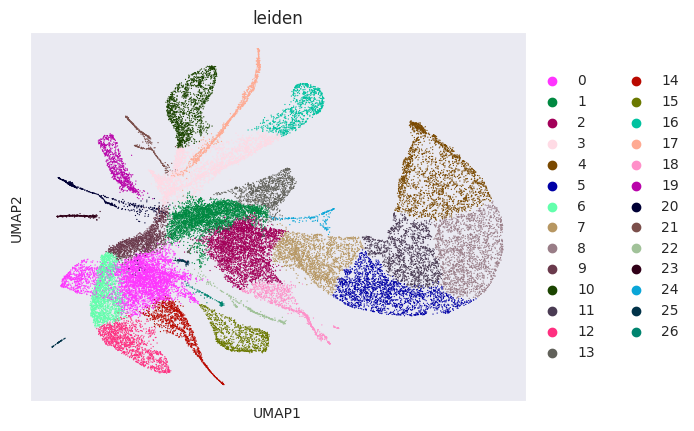

In [73]:
sc.pl.umap(adata_neo_spleen,color=["leiden"])

In [74]:
combined_matrix.obs["tissue"]="Nan"
combined_matrix.obs["anno2"]="Nan"
combined_matrix.obs["leiden"]="Nan"
combined_matrix.obs["batch"]="Nan"

In [75]:
#Load in data in the obs for adata_neo_spleen using index
for i in adata_neo_spleen.obs.index:
    modified_index = i[:-2]
    if modified_index in combined_matrix.obs.index:
        combined_matrix.obs.loc[modified_index, "tissue"] = adata_neo_spleen.obs.loc[i, "tissue"]
        combined_matrix.obs.loc[modified_index, "anno2"] = adata_neo_spleen.obs.loc[i, "anno2"]
        combined_matrix.obs.loc[modified_index, "leiden"] = adata_neo_spleen.obs.loc[i, "leiden"]
        combined_matrix.obs.loc[modified_index, "batch"] = adata_neo_spleen.obs.loc[i, "batch"]
        

In [76]:
combined_matrix.obs

,tissue,anno2,leiden,batch
COL60_ATCCGAACGGTATCCTCAAT,Spleen,Epithelial cell,17,WT1
COL60_CAGGAATCGGCGATGGCGCC,Spleen,Epithelial cell,1,WT1
COL60_ATATCTTCCGGCCGGTCGAG,Spleen,Immune cell,13,WT1
COL60_TGCGTCTATACCAGGCCGCA,Spleen,Immune cell,13,WT1
COL60_CGGAGCGTCATTGATGCTAT,Spleen,Epithelial cell,14,WT1
...,...,...,...,...
COL21_GCGTAAGATCTCGATATTGA,Spleen,Immune cell,1,WT2
COL21_TGAGGTTAGCAACGGACCAA,Spleen,Immune cell,1,WT2
COL21_GTTCGAGGCGGGACTCATTG,Spleen,Immune cell,1,WT2
COL21_TTATTGCTAATCGTAGAGAA,Spleen,Immune cell,7,WT2


In [77]:
combined_matrix.write_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/combined_data_withobs_withleiden.h5ad")

In [32]:
#Write the matrix to a file
combined_matrix.write_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/combined_data_withobs.h5ad")

In [66]:
combined_matrix=anndata.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/combined_data_withobs.h5ad")

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")


In [67]:
combined_matrix

AnnData object with n_obs × n_vars = 58458 × 20278
    obs: 'tissue', 'anno2', 'leiden', 'batch'

In [31]:
combined_matrix.obs["tissue"].value_counts()

tissue
Spleen    58458
Name: count, dtype: int64

In [68]:
#Take only one copy of the cells if duplicates are present
combined_matrix=combined_matrix[~combined_matrix.obs.index.duplicated(keep='first')]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [69]:
combined_matrix

View of AnnData object with n_obs × n_vars = 35549 × 20278
    obs: 'tissue', 'anno2', 'leiden', 'batch'

In [46]:
#QC the data
sc.pp.filter_cells(combined_matrix, min_genes=200)
sc.pp.filter_genes(combined_matrix, min_cells=3)
sc.pp.calculate_qc_metrics(combined_matrix, inplace=True)


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1838: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):
/home/nikvaku/.local/lib/python3.9/site-pack

In [ ]:
#Calculate the missing expression values

In [61]:
import scanpy as sc
import pandas as pd  # Import pandas library explicitly

# Assuming combined_matrix is your AnnData object
# Extract highly variable genes
sc.pp.highly_variable_genes(combined_matrix, flavor='seurat', min_disp=None, max_disp=None, min_mean=None, max_mean=None, n_bins=20, n_top_genes=3000, subset=False, inplace=True)

# Normalization
sc.pp.normalize_total(combined_matrix, target_sum=1e4)

# Logarithmize data and scale it
sc.pp.log1p(combined_matrix)
sc.pp.scale(combined_matrix)

# Perform PCA
sc.tl.pca(combined_matrix, svd_solver='arpack')

# Access the PCA results in the AnnData object
pc_data = combined_matrix.obsm['X_pca']

# Perform clustering (here using Louvain algorithm)
sc.tl.louvain(combined_matrix)

# Access cluster assignments in the AnnData object
cluster_assignments = combined_matrix.obs['louvain']

# Now pc_data contains the principal components, and cluster_assignments contains cluster labels


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/preprocessing/_highly_variable_genes.py:200: RuntimeWarning: overflow encountered in expm1
  X = np.expm1(X)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:11: RuntimeWarning: overflow encountered in multiply
  mean_sq = np.multiply(X, X).mean(axis=axis, dtype=np.float64)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/preprocessing/_utils.py:12: RuntimeWarning: invalid value encountered in subtract
  var = mean_sq - mean**2


TypeError: putmask() argument 1 must be numpy.ndarray, not Series

In [14]:
adata_neo_spleen.obs

,tissue,batch,leiden,anno2
COL49_TCAACGAGGTGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
COL49_TGGTATCAGATTGGAATCTC_3,Spleen,WT1,6,Immune cell
COL49_ACTAGACGTTCTGAACTGGT_3,Spleen,WT1,41,Epithelial cell
COL49_TTGACTTCGTGCGTTCAGCT_3,Spleen,WT1,8,Endothelial cell
COL49_GGATTCTCGGGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
...,...,...,...,...
COL96_TTGGAACTGGAGTTGCATCT_10,Spleen,WT5,10,Epithelial cell
COL96_TGATCTTCTTAGCGTCAATG_10,Spleen,WT5,6,Immune cell
COL96_TGAATCTGATACGAGGACCT_10,Spleen,WT5,23,Immune cell
COL97_TACGGTAGTCACTATCCGCA_10,Spleen,WT5,26,Immune cell


In [150]:
#Read matrix file as anndata
adata_ax_neo_raw=

ParserError: Error tokenizing data. C error: Calling read(nbytes) on source failed. Try engine='python'.

In [59]:
adata_neo_spleen.obs

,tissue,batch,leiden,anno2
COL49_TCAACGAGGTGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
COL49_TGGTATCAGATTGGAATCTC_3,Spleen,WT1,6,Immune cell
COL49_ACTAGACGTTCTGAACTGGT_3,Spleen,WT1,41,Epithelial cell
COL49_TTGACTTCGTGCGTTCAGCT_3,Spleen,WT1,8,Endothelial cell
COL49_GGATTCTCGGGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
...,...,...,...,...
COL96_TTGGAACTGGAGTTGCATCT_10,Spleen,WT5,10,Epithelial cell
COL96_TGATCTTCTTAGCGTCAATG_10,Spleen,WT5,6,Immune cell
COL96_TGAATCTGATACGAGGACCT_10,Spleen,WT5,23,Immune cell
COL97_TACGGTAGTCACTATCCGCA_10,Spleen,WT5,26,Immune cell


In [60]:
adata_neo_spleen=adata_neo_spleen[adata_neo_spleen.obs["anno2"]=="Immune cell"]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [61]:
#Load in the Pleurodeles spleen dataset
adata_pl=anndata.read_h5ad('/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Inter_data/spleen_merged.h5ad')

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

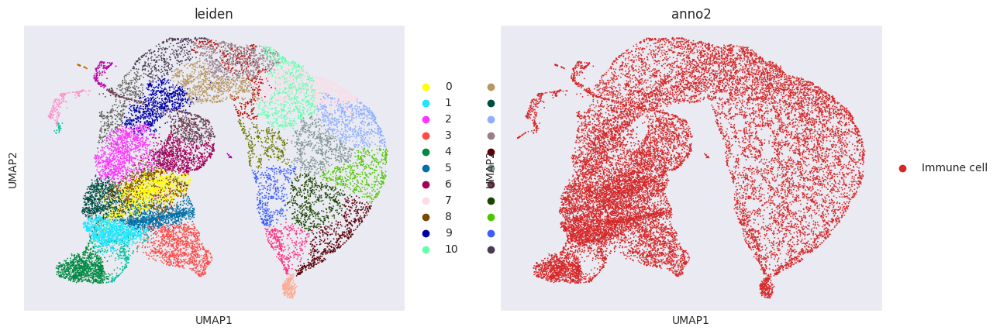

In [62]:
#Perform the clustering
#sc.pp.log1p(adata_ax_neo)
#sc.pp.scale(adata_ax_neo,max_value=10)
#sc.tl.pca(adata_ax_neo)
sc.pp.neighbors(adata_neo_spleen)
sc.tl.umap(adata_neo_spleen)
sc.tl.leiden(adata_neo_spleen)
sc.pl.umap(adata_neo_spleen,color=["leiden","anno2"])

In [63]:
#Concate the two datasets
adata_neo_spleen.obs["anno"]='axl'
adata_pl.obs["anno"]='pl'
merged_adata=adata_neo_spleen.concatenate(adata_pl,join='outer')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/.

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


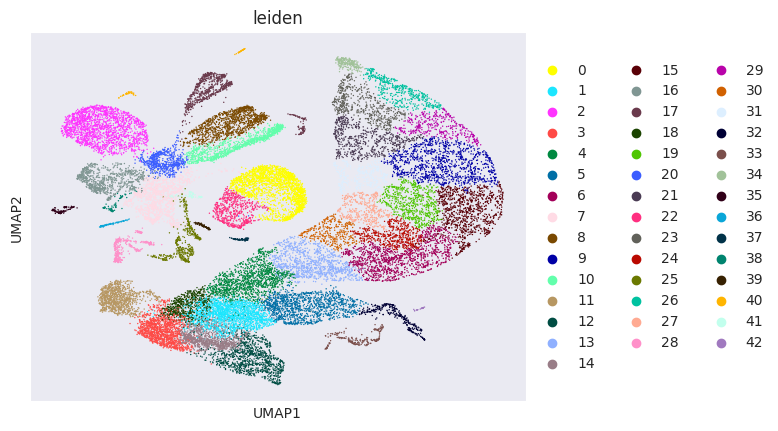

In [64]:
#Perform the clustering
sc.pp.neighbors(merged_adata)
sc.tl.umap(merged_adata)
sc.tl.leiden(merged_adata)
sc.pl.umap(merged_adata,color=["leiden"])

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


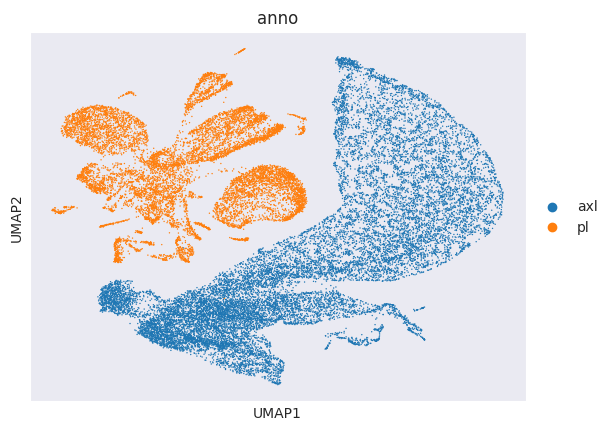

In [65]:
sc.pl.umap(merged_adata,color=["anno"])

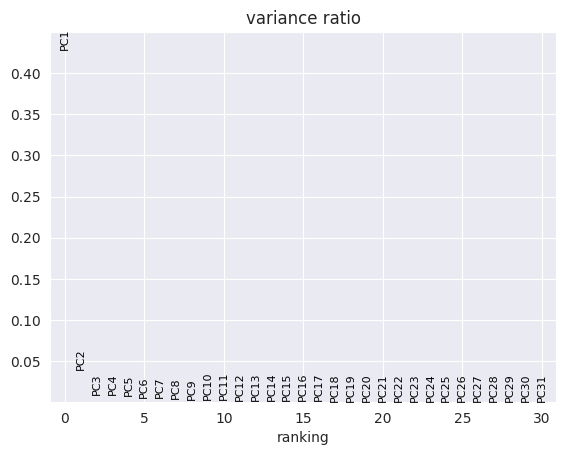

In [49]:
sc.tl.pca(merged_adata)
sc.pl.pca_variance_ratio(merged_adata)

2024-01-10 14:02:58,632 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-10 14:03:11,422 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-10 14:03:11,524 - harmonypy - INFO - Iteration 1 of 10
2024-01-10 14:03:16,759 - harmonypy - INFO - Iteration 2 of 10
2024-01-10 14:03:21,848 - harmonypy - INFO - Converged after 2 iterations
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector =

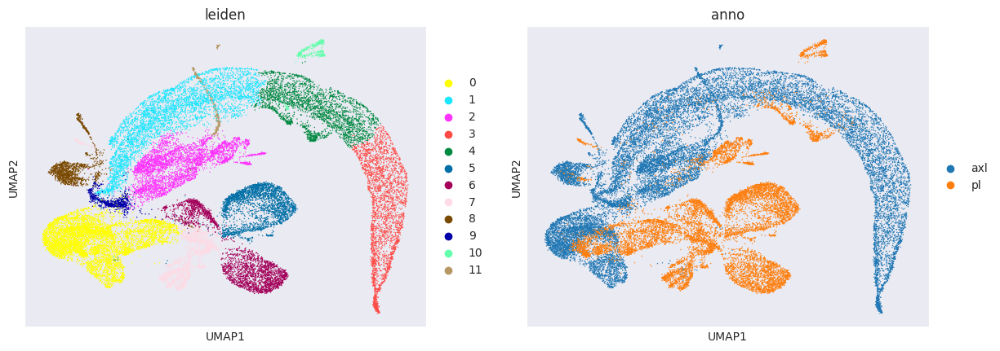

In [68]:
#Perform batch correction using Harmony
sc.external.pp.harmony_integrate(merged_adata,key='anno',max_iter_harmony=10)
#Recluster
sc.pp.neighbors(merged_adata,n_neighbors=100,n_pcs=40,use_rep="X_pca_harmony")
sc.tl.umap(merged_adata)
sc.tl.leiden(merged_adata,resolution=0.2)
sc.pl.umap(merged_adata,color=["leiden","anno"])

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


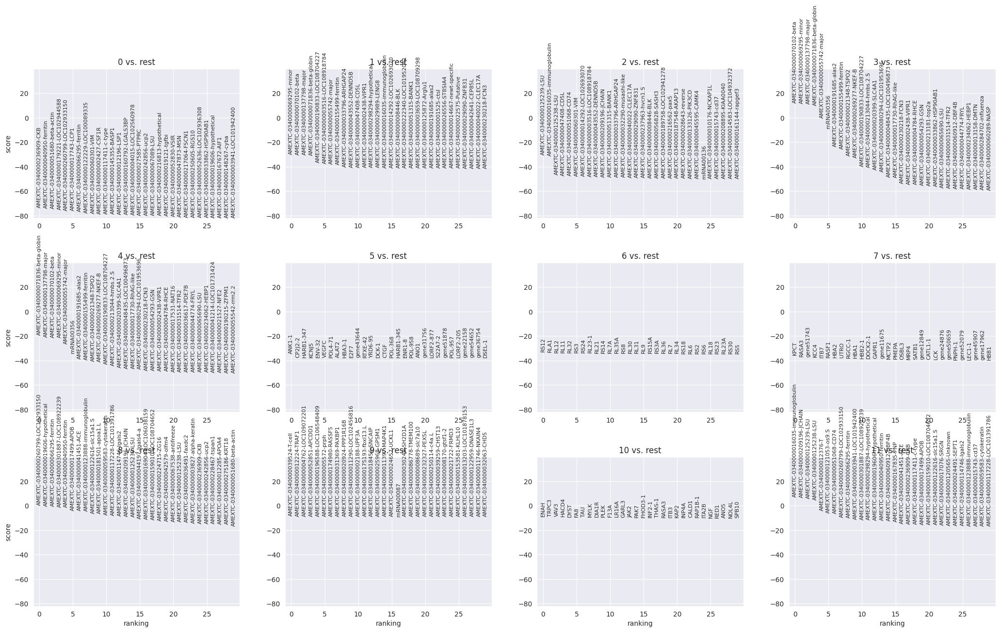

In [69]:
#DEG analysis
sc.tl.rank_genes_groups(merged_adata,groupby="leiden",method="wilcoxon")
sc.pl.rank_genes_groups(merged_adata,groupby="leiden",n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/__init__.py:430: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(ymin, ymax)


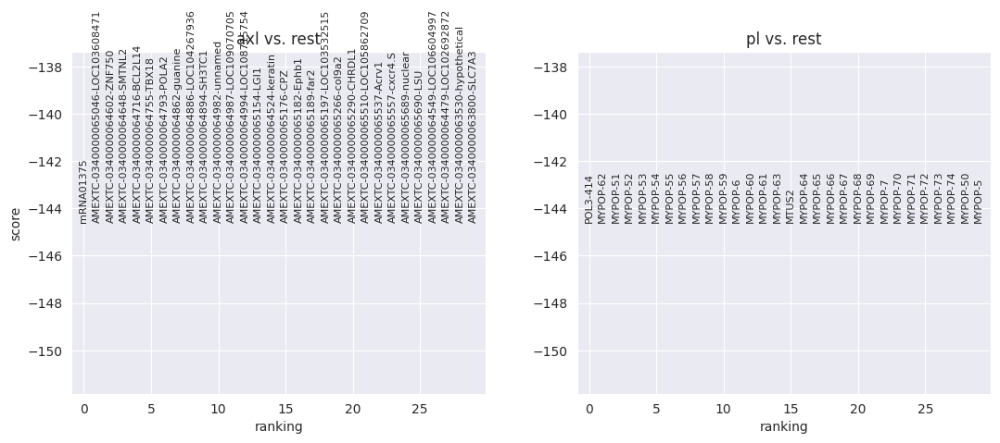

In [75]:
sc.tl.rank_genes_groups(merged_adata,groupby="anno",method="wilcoxon")
sc.pl.rank_genes_groups(merged_adata,groupby="anno",n_genes=30)

In [81]:
cluster_0=merged_adata[merged_adata.obs["leiden"]=="4"]
cluster_0

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


View of AnnData object with n_obs × n_vars = 2753 × 32758
    obs: 'tissue', 'batch', 'leiden', 'anno2', 'anno', 'background_fraction', 'cell_probability', 'cell_size', 'droplet_efficiency', 'soup_assign', 'Animal', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'mt_score', 'hematopoetic_score', 'B_cells_score', 'prob_cells_score', 'macrophages_score', 'erythrocyte_progen_score', 'plasma_cells_score', 'neutrophil_score', 'cd4_tcell_score', 'cd8_tcell_score', 'dataset', 'Status'
    var: 'feature_type-1', 'genome-1', 'ambient_expression-0-1', 'gene_id-0-1', 'cellbender_analyzed-0-1', 'n_cells-0-1', 'mt-0-1', 'n_cells_by_counts-0-1', 'mean_counts-0-1', 'pct_dropout_by_counts-0-1', 'total_counts-0-1', 'mean-0-1', 'std-0-1', 'ambient_expression-1-1', 'gene_id-1-1', 'cellbender_analyzed-1-1', 'n_cells-1-1', 'mt-1-1', 'n_cells_by_counts-1-1', 'mean_counts-1-1', 'pct_dropout_by_counts-1-1', 'total_counts-1-1', 'mean-1-1', 'std-1-1', 'highly_variable-1-1', 

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/__init__.py:430: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(ymin, ymax)


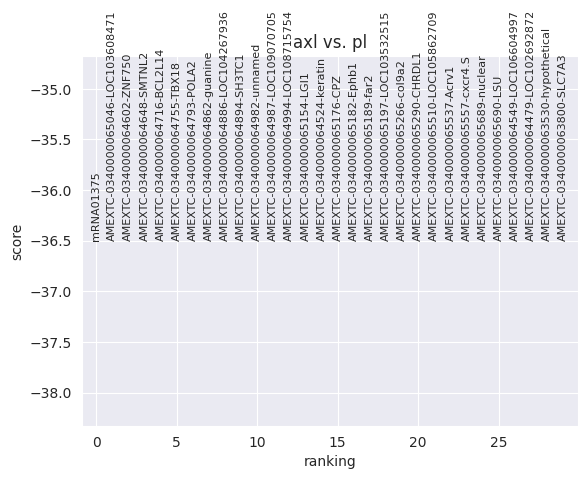

In [88]:
sc.tl.rank_genes_groups(merged_adata,groupby="anno",reference='pl',method="wilcoxon")
sc.pl.rank_genes_groups(merged_adata,groupby="anno",reference='pl',n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/__init__.py:430: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(ymin, ymax)


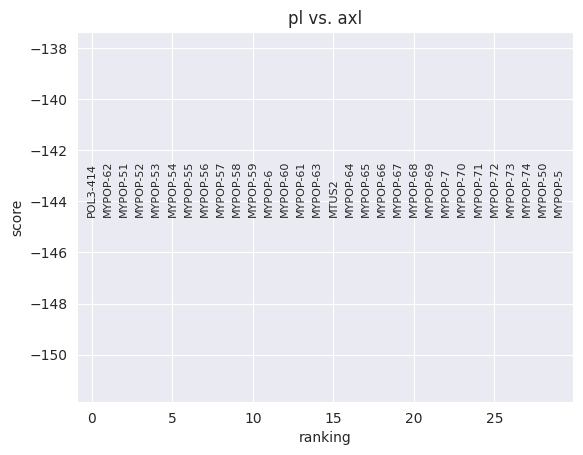

In [91]:
sc.tl.rank_genes_groups(merged_adata,groupby="anno",reference='axl',method="wilcoxon")
sc.pl.rank_genes_groups(merged_adata,groupby="anno",reference='axl',n_genes=30)

In [93]:
adata_pl.var_names

Index(['SPX2', 'gene26600', 'HARB1', 'MYPOP', 'gene26611', 'LIN1', 'HARB1-1',
       'RL23', 'LORF2', 'gene26619',
       ...
       'H2A1E-1', 'H15-1', 'H1-1', 'YG31B-1225', 'TSN31-2', 'RTBS-138',
       'NU5M-1', 'COX1-1', 'COX1-2', 'NU2M'],
      dtype='object', length=29758)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

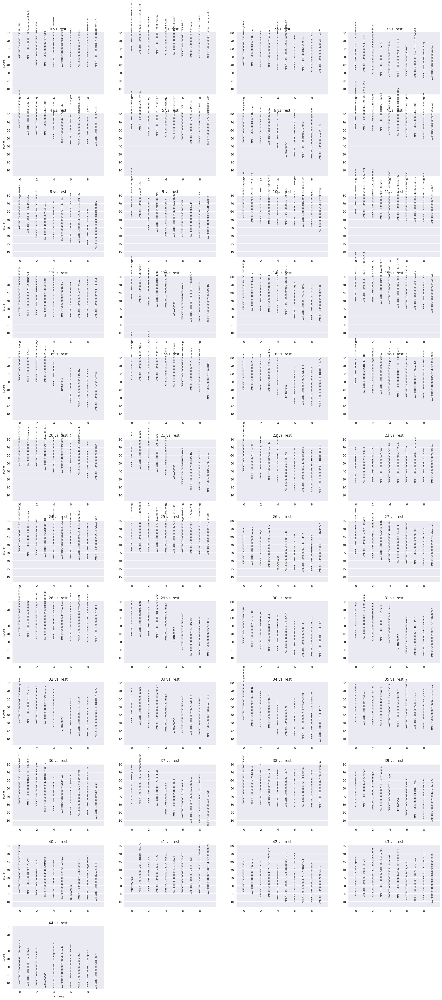

In [69]:
sc.tl.rank_genes_groups(adata_neo_spleen_immun,groupby="leiden",method="wilcoxon")
sc.pl.rank_genes_groups(adata_neo_spleen,groupby="leiden",n_genes=10)

KeyError: 'Could not find key PTPRC in .var_names or .obs.columns.'

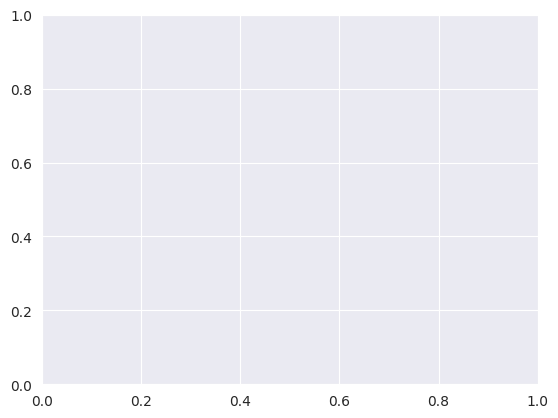

In [67]:
sc.pl.umap(adata_neo_spleen,color=["PTPRC"],legend_loc="on data")

In [54]:
adata_neo_spleen_immun=adata_neo_spleen[adata_neo_spleen.obs["anno2"]=="Immune cell"]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


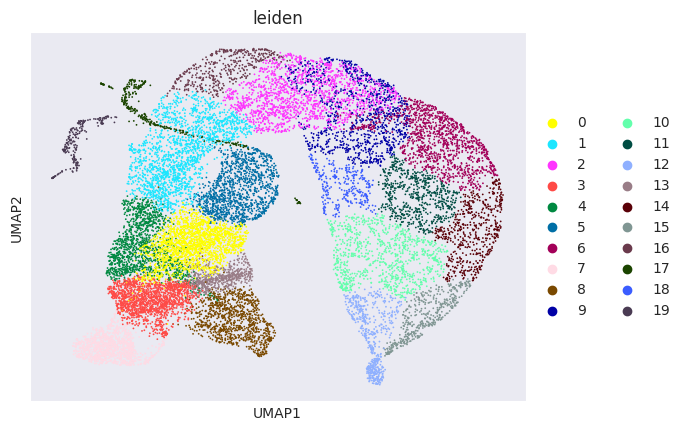

In [56]:
#Perform the clustering
sc.pp.neighbors(adata_neo_spleen_immun)
sc.tl.umap(adata_neo_spleen_immun)
sc.tl.leiden(adata_neo_spleen_immun,resolution=0.5)
sc.pl.umap(adata_neo_spleen_immun,color=["leiden"])

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:420: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, 'logfoldchanges'] = np.log2(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/tools/_rank_genes_group

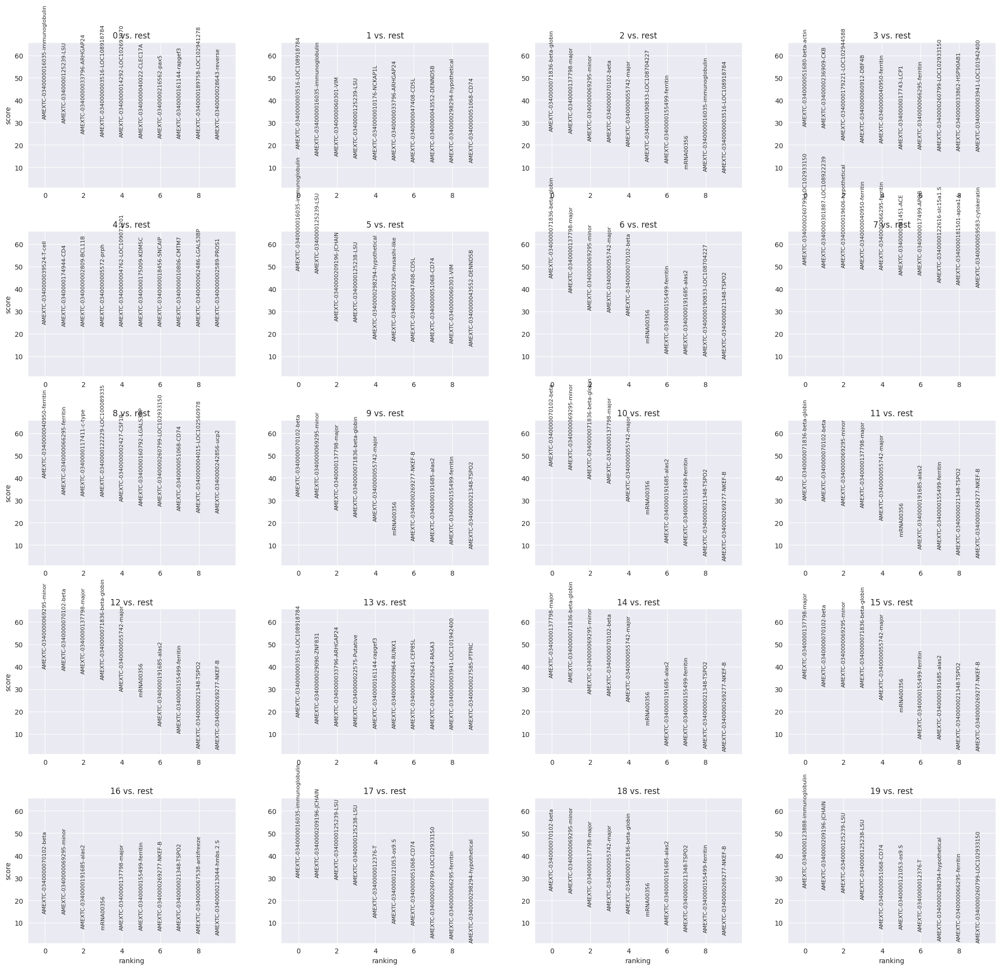

In [70]:
sc.tl.rank_genes_groups(adata_neo_spleen_immun,groupby="leiden",method="wilcoxon")
sc.pl.rank_genes_groups(adata_neo_spleen_immun,groupby="leiden",n_genes=10)

In [71]:
#Save the data
adata_neo_spleen_immun.write_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/adata_neo_spleen_immune.h5ad")

In [58]:
#Load in the post metamorphic data
adata_ax_post=sc.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/Anno/metasctscanpy.h5ad")

In [61]:
adata_post_spleen=adata_ax_post[adata_ax_post.obs["tissue"]=="Spleen"]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


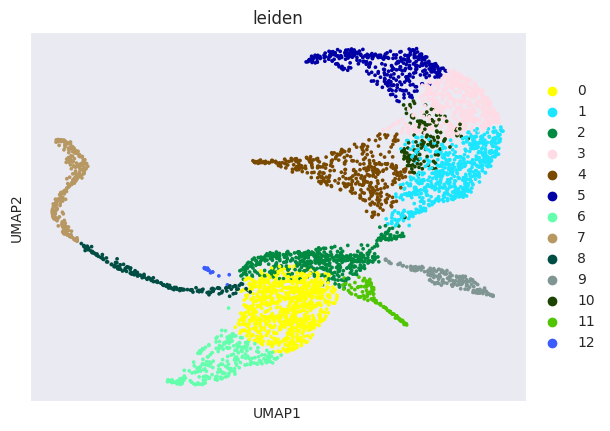

In [63]:
sc.pp.neighbors(adata_post_spleen,n_neighbors=30)
sc.tl.umap(adata_post_spleen)
sc.tl.leiden(adata_post_spleen,resolution=0.5)
sc.pl.umap(adata_post_spleen,color=["leiden"])

In [66]:
adata_post_spleen.obs


,tissue,batch,leiden
COL11_GGAGAATGGCTAACGATCCA_1,Spleen,Meta1,2
COL14_ATGAGTAATATTCATAGGAC_1,Spleen,Meta1,0
COL18_ATGACGGCTATAGGCCATAG_1,Spleen,Meta1,0
COL22_TAACTGGCTTAGGTATACTC_1,Spleen,Meta1,2
COL55_CATGCGAGAACGTCGCAGCC_1,Spleen,Meta1,2
...,...,...,...
COL80_AACGCAATGGATGCAATATG_3,Spleen,Meta3,2
COL80_ATCTTCAGATAATACGCAGG_3,Spleen,Meta3,0
COL80_TTATAGGAGACCGCTATATT_3,Spleen,Meta3,11
COL80_AGGAGTAAGGATGCAATATG_3,Spleen,Meta3,11


In [29]:
#Load in the gff file
gff_file="/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Raw_data/data/Am_34-AmexG_v3.gff3"

examiner = GFFExaminer()
in_handle = open(gff_file)
pprint.pprint(examiner.available_limits(in_handle))
in_handle.close()

{'gff_id': {('AMEXG_0030000001',): 340,
            ('AMEXG_0030000002',): 27,
            ('AMEXG_0030000003',): 15,
            ('AMEXG_0030000004',): 79,
            ('AMEXG_0030000005',): 169,
            ('AMEXG_0030000006',): 402,
            ('AMEXG_0030000007',): 395,
            ('AMEXG_0030000008',): 346,
            ('AMEXG_0030000009',): 354,
            ('AMEXG_0030000010',): 127,
            ('AMEXG_0030000011',): 196,
            ('AMEXG_0030000012',): 17,
            ('AMEXG_0030000013',): 277,
            ('AMEXG_0030000014',): 335,
            ('AMEXG_0030000015',): 532,
            ('AMEXG_0030000016',): 257,
            ('AMEXG_0030000017',): 136,
            ('AMEXG_0030000018',): 21,
            ('AMEXG_0030000019',): 177,
            ('AMEXG_0030000020',): 110,
            ('AMEXG_0030000021',): 62,
            ('AMEXG_0030000022',): 95,
            ('AMEXG_0030000023',): 275,
            ('AMEXG_0030000024',): 339,
            ('AMEXG_0030000025',): 87,
        

In [39]:
#Load in the gff file
from BCBio import GFF
in_handle = open(gff_file)
for rec in GFF.parse(in_handle,target_lines=1):
    print(rec)
in_handle.close()

ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142466
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142466
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142466
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1141904
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142148
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142148
ID: AMEXG_0030008744
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1142148
ID: AMEXG_0030008744
Name: <unknown name>
Descri

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2765783
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2841795
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2866132
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2915737
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2923638
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2983541
ID: AMEXG_0030005608
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2986360
ID: AMEXG_0030005608
Name: <unknown name>
Descri

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 642282
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 638019
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 628056
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 612676
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 603255
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 591795
ID: AMEXG_0030001437
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 566209
ID: AMEXG_0030001437
Name: <unknown name>
Description: 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ID: AMEXG_0030000824
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2707066
ID: AMEXG_0030000824
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2710452
ID: AMEXG_0030010496
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 144734
ID: AMEXG_0030010496
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 144734
ID: AMEXG_0030010496
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 137406
ID: AMEXG_0030010496
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 137494
ID: AMEXG_0030010496
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 137710
ID: AMEXG_0030010496
Name: <unknown name>
Description

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ID: AMEXG_0030004899
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2478046
ID: AMEXG_0030004899
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2478107
ID: AMEXG_0030004899
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 2524160
ID: AMEXG_0030017758
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 25817
ID: AMEXG_0030017758
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 25817
ID: AMEXG_0030017758
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 25817
ID: AMEXG_0030017758
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 18398
ID: AMEXG_0030042429
Name: <unknown name>
Description: <

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



ID: AMEXG_0030004636
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1565047
ID: AMEXG_0030004636
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1494469
ID: AMEXG_0030004636
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1491679
ID: AMEXG_0030004636
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1487724
ID: AMEXG_0030001040
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1442816
ID: AMEXG_0030001040
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1442816
ID: AMEXG_0030001040
Name: <unknown name>
Description: <unknown description>
Number of features: 1
Undefined sequence of length 1398630
ID: AMEXG_0030001040
Name: <unknown name>
Descri

KeyboardInterrupt: 

In [100]:
#Load in the immune file for pleurodeles
#B cells
adata_pl_b=sc.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Final_Data/spleen_b_cells.h5ad")
adata_pl_t=sc.read_h5ad("/home/nikvaku/snic2022-6-312/LabMemberScratchDir/Nikhilesh/Final_Data/spleen_t_cells.h5ad")
adata_pl_b.obs["anno"]="pl"
adata_pl_t.obs["anno"]="pl"
adata_pl_b.obs["anno2"]="B cell"
adata_pl_t.obs["anno2"]="T cell"

In [101]:
merged_b_cells=adata_neo_spleen.concatenate(adata_pl_b,join='outer')

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/.

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


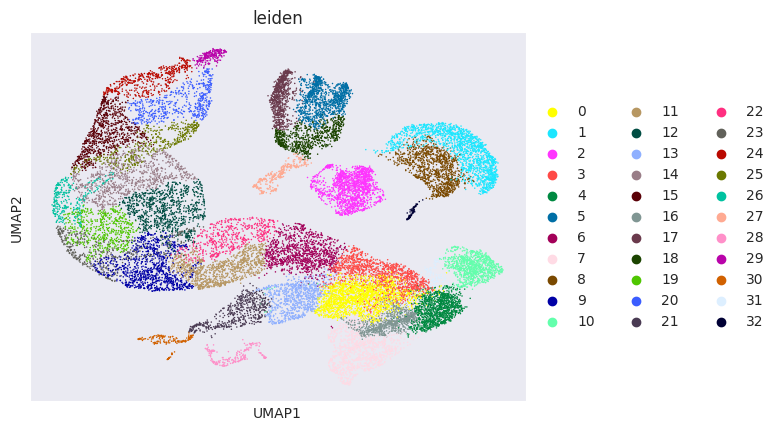

In [102]:
#Perform the clustering
sc.pp.neighbors(merged_b_cells)
sc.tl.umap(merged_b_cells)
sc.tl.leiden(merged_b_cells)
sc.pl.umap(merged_b_cells,color=["leiden"])

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

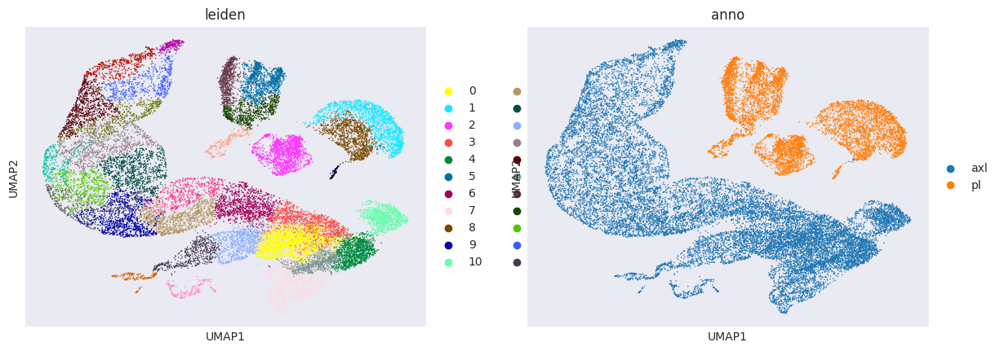

In [103]:
sc.pl.umap(merged_b_cells,color=["leiden","anno"])

2024-01-11 10:57:02,847 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-11 10:57:14,025 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-11 10:57:14,122 - harmonypy - INFO - Iteration 1 of 10
2024-01-11 10:57:18,096 - harmonypy - INFO - Iteration 2 of 10
2024-01-11 10:57:22,375 - harmonypy - INFO - Converged after 2 iterations
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector =

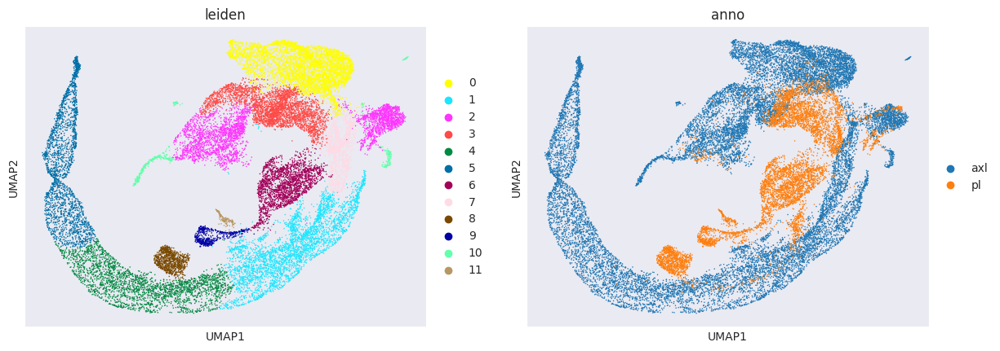

In [104]:
#Perform batch correction using Harmony
sc.external.pp.harmony_integrate(merged_b_cells,key='anno',max_iter_harmony=10)
#Recluster
sc.pp.neighbors(merged_b_cells,n_neighbors=100,n_pcs=40,use_rep="X_pca_harmony")
sc.tl.umap(merged_b_cells)
sc.tl.leiden(merged_b_cells,resolution=0.2)
sc.pl.umap(merged_b_cells,color=["leiden","anno"])

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


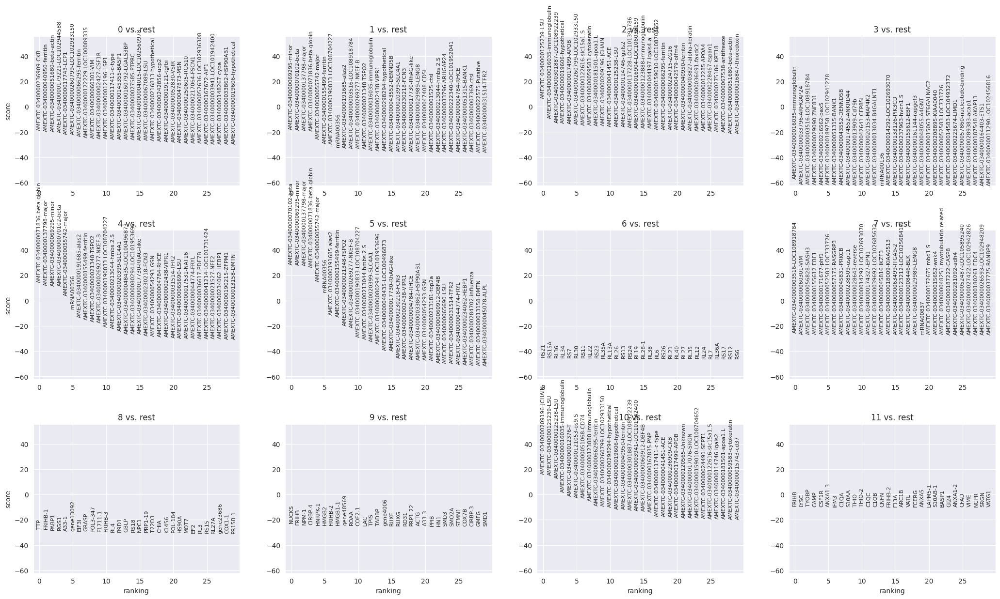

In [105]:
#DEG analysis
sc.tl.rank_genes_groups(merged_b_cells,groupby="leiden",method="wilcoxon")
sc.pl.rank_genes_groups(merged_b_cells,groupby="leiden",n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/__init__.py:430: UserWarning: Attempting to set identical low and high ylims makes transformation singular; automatically expanding.
  ax.set_ylim(ymin, ymax)


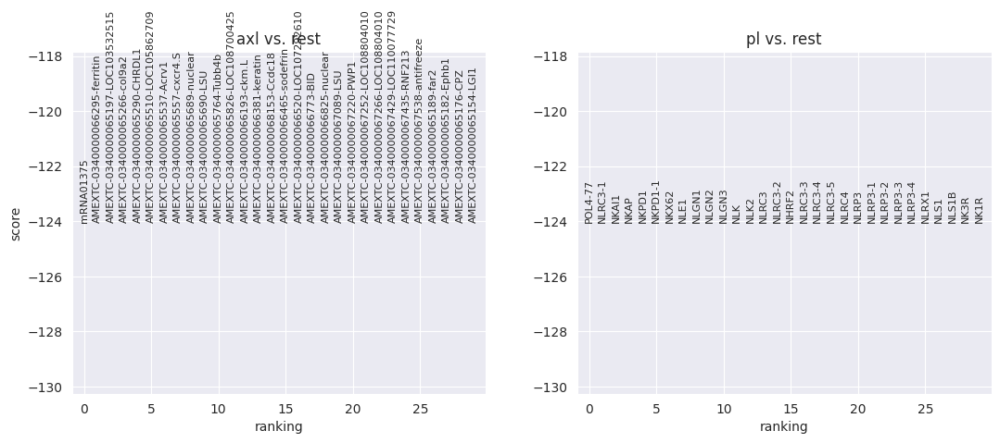

In [106]:
sc.tl.rank_genes_groups(merged_b_cells,groupby="anno",method="wilcoxon")
sc.pl.rank_genes_groups(merged_b_cells,groupby="anno",n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

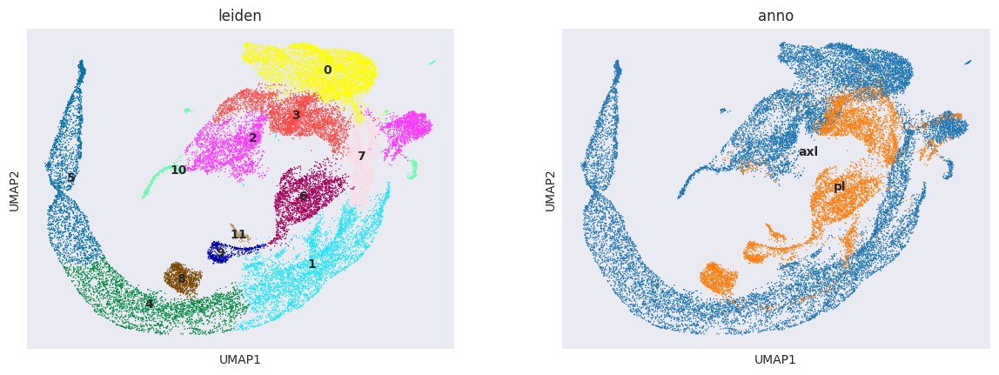

In [107]:
sc.pl.umap(merged_b_cells,color=["leiden","anno"],legend_loc="on data")

In [108]:
#Subset the data
adata_neo_spleen_cluster4=merged_adata[merged_adata.obs["leiden"]=="4"]
adata_pl_b_cluster8=adata_pl_b[adata_pl_b.obs["leiden"]=="8"]


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [109]:
#Concatenate the two datasets
merged_b_cells_test=adata_neo_spleen_cluster4.concatenate(adata_pl_b_cluster8,join='outer')


/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:1015: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  concat_indices = concat_indices.str.cat(label_col.map(str), sep=index_unique)
/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/merge.py:217: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(dtype):
/home/nikvaku/.

2024-01-11 11:30:01,097 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2024-01-11 11:30:03,155 - harmonypy - INFO - sklearn.KMeans initialization complete.
2024-01-11 11:30:03,174 - harmonypy - INFO - Iteration 1 of 10
2024-01-11 11:30:03,818 - harmonypy - INFO - Iteration 2 of 10
2024-01-11 11:30:04,424 - harmonypy - INFO - Iteration 3 of 10
2024-01-11 11:30:04,849 - harmonypy - INFO - Iteration 4 of 10
2024-01-11 11:30:05,129 - harmonypy - INFO - Iteration 5 of 10
2024-01-11 11:30:05,407 - harmonypy - INFO - Iteration 6 of 10
2024-01-11 11:30:05,684 - harmonypy - INFO - Iteration 7 of 10
2024-01-11 11:30:05,954 - harmonypy - INFO - Iteration 8 of 10
2024-01-11 11:30:06,239 - harmonypy - INFO - Converged after 8 iterations
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not

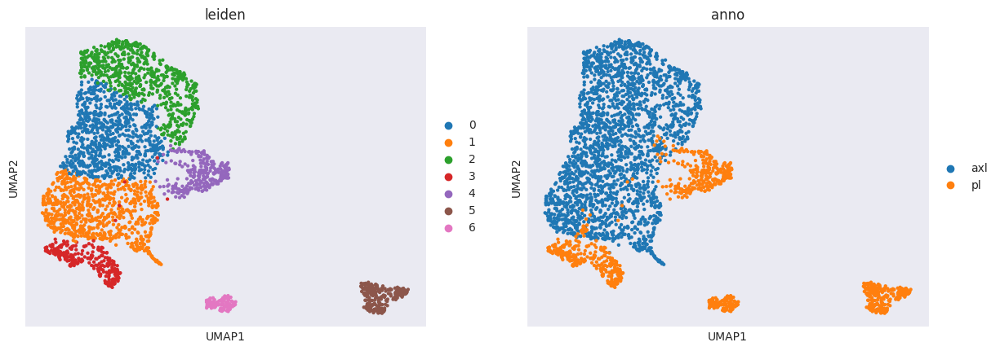

In [110]:
#Perform the clustering
sc.external.pp.harmony_integrate(merged_b_cells_test,key='anno',max_iter_harmony=10)
#Recluster
sc.pp.neighbors(merged_b_cells_test,n_neighbors=100,n_pcs=40,use_rep="X_pca_harmony")
sc.tl.umap(merged_b_cells_test)
sc.tl.leiden(merged_b_cells_test,resolution=0.2)
sc.pl.umap(merged_b_cells_test,color=["leiden","anno"])


/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axi

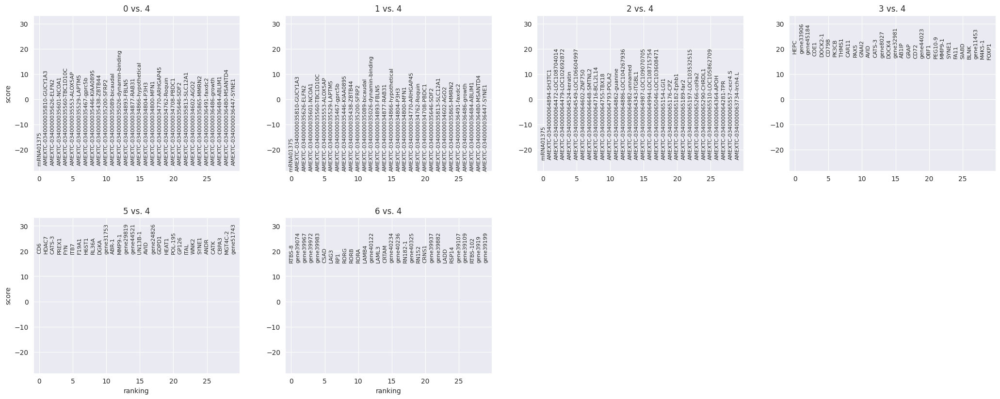

In [118]:
#DEG analysis
sc.tl.rank_genes_groups(merged_b_cells_test,groupby="leiden",reference="4",method="wilcoxon")
sc.pl.rank_genes_groups(merged_b_cells_test,groupby="leiden",reference="4",n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axi

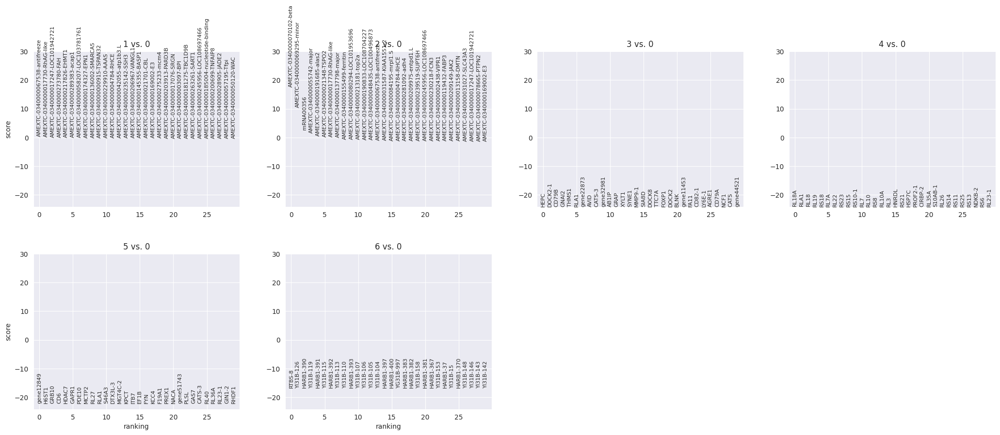

In [120]:
#DEG analysis
sc.tl.rank_genes_groups(merged_b_cells_test,groupby="leiden",reference="0",method="wilcoxon")
sc.pl.rank_genes_groups(merged_b_cells_test,groupby="leiden",reference="0",n_genes=30)

/home/nikvaku/.local/lib/python3.9/site-packages/numpy/core/fromnumeric.py:84: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


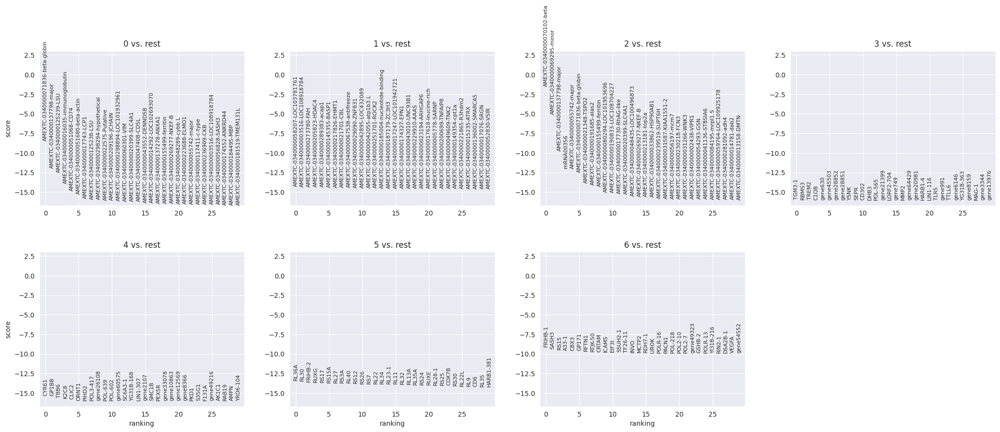

In [122]:
#DEG analysis
sc.tl.rank_genes_groups(merged_b_cells_test,groupby="leiden",method="wilcoxon")
sc.pl.rank_genes_groups(merged_b_cells_test,groupby="leiden",n_genes=30)

In [113]:
for i in adata_neo_spleen.var_names:
    if i.endswith("CD74"):
        print(i)

AMEXTC-0340000051068-CD74


/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(values):
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/nikvaku/.local/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:1208: FutureWarning: is_categorical_dtype is deprecate

KeyError: 'Could not find key CD74 in .var_names or .obs.columns.'

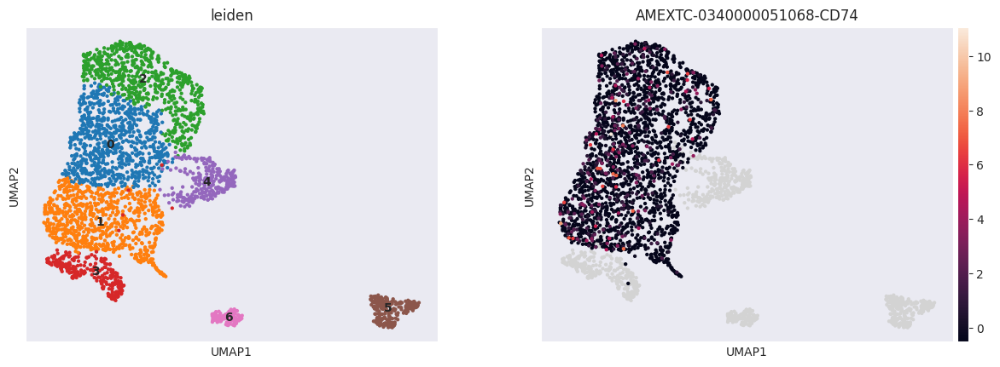

In [114]:
sc.pl.umap(merged_b_cells_test,color=["leiden","AMEXTC-0340000051068-CD74","CD74"],legend_loc="on data")

In [123]:
adata_ax_neo.obs

,tissue,batch,leiden,anno2
COL09_TTATTGCTAACAGATTCGAT_1,Intestine,WT1,40,Secretory cell
COL09_GATCCGCCATTCAGCTCTAA_1,Intestine,WT1,40,Secretory cell
COL09_AATTCAGAACACTTAACTAG_1,Intestine,WT1,40,Secretory cell
COL09_TACTCGAACTCAGATTCGAT_1,Intestine,WT1,14,Epithelial cell
COL09_AGTCTTAATTGCCAACGCCA_1,Intestine,WT1,40,Secretory cell
...,...,...,...,...
COL97_TTCCATTACTGTCCTTAAGA_10,Fore limb,WT5,7,Stromal cell
COL97_TTGGCTCATTGGCCAGTCCG_10,Intestine,WT5,24,Secretory cell
COL97_AGTCGCATGTTTATCCGGAT_10,Cloacal chamber,WT5,44,Secretory cell
COL97_TACTCGAACTTGGCCGGCCT_10,Skin,WT5,52,Stromal cell


In [124]:
adata_ax_neo_spleen=adata_ax_neo[adata_ax_neo.obs["tissue"]=="Spleen"]

/home/nikvaku/.local/lib/python3.9/site-packages/anndata/_core/anndata.py:1113: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if not is_categorical_dtype(df_full[k]):


In [125]:
adata_ax_neo_spleen.obs

,tissue,batch,leiden,anno2
COL49_TCAACGAGGTGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
COL49_TGGTATCAGATTGGAATCTC_3,Spleen,WT1,6,Immune cell
COL49_ACTAGACGTTCTGAACTGGT_3,Spleen,WT1,41,Epithelial cell
COL49_TTGACTTCGTGCGTTCAGCT_3,Spleen,WT1,8,Endothelial cell
COL49_GGATTCTCGGGTACTAGTAA_3,Spleen,WT1,35,Secretory cell
...,...,...,...,...
COL96_TTGGAACTGGAGTTGCATCT_10,Spleen,WT5,10,Epithelial cell
COL96_TGATCTTCTTAGCGTCAATG_10,Spleen,WT5,6,Immune cell
COL96_TGAATCTGATACGAGGACCT_10,Spleen,WT5,23,Immune cell
COL97_TACGGTAGTCACTATCCGCA_10,Spleen,WT5,26,Immune cell


In [127]:
adata_ax_neo

AnnData object with n_obs × n_vars = 719056 × 3000
    obs: 'tissue', 'batch', 'leiden', 'anno2'
    uns: 'anno2_colors', 'batch_colors', 'leiden', 'leiden_colors', 'neighbors', 'pca', 'tissue_colors'
    obsm: 'X_pca', 'X_tsne'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'